<a href="https://colab.research.google.com/github/Amit-Jindar/Urban-Transport-Data-Analytics/blob/main/SmartSafar.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

Problem 1:

Given the static data points of the city like stop_ids, stop_lat, stop_long, routes details and static timeframed live location of buses of a set of routes up to time t on a particular day, Predict the arrival time of these buses at various bus stops along their routes up to the end of the route?

Step 1. Load static city data points and merge them and create a master_static file to find distance between each stop_id by haversine formula using latitude and longitude also map them on folium graph.

Step 2. Clean the GPS Glitch noise from the parquet files.

Step 3. Merge and map  the GPS parquet files with master_static.

Step 4. Now we have distance from master_static and delta t of each vechile from consecutive timestamps so we can easily determine the average speed of each vechile and future feature engineering.

Step 5. Split the 21 days data to 15 days train and last 6 days test.

Step 6. Start training the XgBoost + LSTM models to predict ETA on each stop of a route.




# Sample Data in Csv


In [ ]:
import pandas as pd

# Load CSVs
route_mapping_df = pd.read_csv("/content/drive/MyDrive/SmartSafar/raw/csv/route_mapping_IUDX.csv")
route_sequence_df = pd.read_csv("/content/drive/MyDrive/SmartSafar/raw/csv/route_to_stop_sequence.csv")
routes_df = pd.read_csv("/content/drive/MyDrive/SmartSafar/raw/csv/routes.csv")
stops_df = pd.read_csv("/content/drive/MyDrive/SmartSafar/raw/csv/stops_0.csv")

# Quick inspection
print("Route Mapping:", route_mapping_df.shape)
print(route_mapping_df.head(3))

print("\nRoute to Stop Sequence:", route_sequence_df.shape)
print(route_sequence_df.head(3))

print("\nRoutes:", routes_df.shape)
print(routes_df.head(3))

print("\nStops:", stops_df.shape)
print(stops_df.head(3))



Route Mapping: (106955, 11)
                    _id                                             _index  \
0  mig4TpgB8e29sV5mz-mW  iudx__7dde01b1-1865-43fe-9676-d176f06dc2c0-000017   
1  myg4TpgB8e29sV5mz-mW  iudx__7dde01b1-1865-43fe-9676-d176f06dc2c0-000017   
2  nCg4TpgB8e29sV5mz-mW  iudx__7dde01b1-1865-43fe-9676-d176f06dc2c0-000017   

   _score  agency_id                                    id  \
0   8.819         38  4dd18ca8-40ef-4560-a1f4-0a9483e7ece4   
1   8.819         38  4dd18ca8-40ef-4560-a1f4-0a9483e7ece4   
2   8.819         38  4dd18ca8-40ef-4560-a1f4-0a9483e7ece4   

           observationDateTime  \
0  Jul 28, 2025 @ 05:00:00.000   
1  Jul 28, 2025 @ 05:00:00.000   
2  Jul 28, 2025 @ 05:00:00.000   

                                         route_desc route_id route_long_name  \
0  Central Silk Board - Yeshawanthapura Bus Station    3,040         CSB-YBS   
1    Dyavalingaiahnapalya - KR Market (Kalasipalya)    2,517         DLP-KMT   
2             Sri Ramapura - Kemp

# Null value in CSV



In [ ]:
import pandas as pd

# Directory where the CSV files are located
csv_dir = "/content/drive/MyDrive/SmartSafar/raw/csv"

# Mapping of descriptive names to filenames
files = {
    "Stops": "stops_0.csv",
    "Routes": "routes.csv",
    "Route_Stop_Map": "route_to_stop_sequence.csv",
    "Route_Mapping": "route_mapping_IUDX.csv"
}

# Loop through each file and check for nulls
for name, file in files.items():
    print(f"\n🔎 Checking nulls in {name} ...")
    df = pd.read_csv(f"{csv_dir}/{file}")
    null_counts = df.isnull().sum()

    # Display null counts only if there are any nulls
    if null_counts.sum() == 0:
        print("No null values found.")
    else:
        print(null_counts[null_counts > 0])





🔎 Checking nulls in Stops ...
No null values found.

🔎 Checking nulls in Routes ...
No null values found.

🔎 Checking nulls in Route_Stop_Map ...
No null values found.

🔎 Checking nulls in Route_Mapping ...
No null values found.


# Master csv schema


In [ ]:
import pandas as pd
import sys

def check_csv_schema(file_path):
    """
    Reads a CSV file and prints the column names and their inferred data types.

    Args:
        file_path (str): The path to the CSV file.
    """
    try:
        # Read the CSV file into a pandas DataFrame
        df = pd.read_csv(file_path)

        # Check if the DataFrame is empty
        if df.empty:
            print("The CSV file is empty.")
            return

        # Print the column names
        print("Column Names:")
        for col in df.columns:
            print(f"- {col}")

        print("\n" + "="*30 + "\n")

        # Print the data types using the .info() method
        print("Data Types (via .info() method):")
        df.info()

        print("\n" + "="*30 + "\n")

        # Print the data types using the .dtypes attribute
        print("Data Types (via .dtypes attribute):")
        print(df.dtypes)

    except FileNotFoundError:
        print(f"Error: The file '{file_path}' was not found.")
        sys.exit(1)
    except Exception as e:
        print(f"An error occurred: {e}")
        sys.exit(1)

if __name__ == "__main__":
    # Specify the path to your CSV file
    csv_file = '/content/drive/MyDrive/SmartSafar/processed/master.csv'
    check_csv_schema(csv_file)


Column Names:
- route_id
- route_short_name
- stop_id
- stop_seq
- latitude
- longitude
- stop_name


Data Types (via .info() method):
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 193517 entries, 0 to 193516
Data columns (total 7 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   route_id          193517 non-null  int64  
 1   route_short_name  193472 non-null  object 
 2   stop_id           193517 non-null  int64  
 3   stop_seq          193517 non-null  int64  
 4   latitude          193517 non-null  float64
 5   longitude         193517 non-null  float64
 6   stop_name         193517 non-null  object 
dtypes: float64(2), int64(3), object(2)
memory usage: 10.3+ MB


Data Types (via .dtypes attribute):
route_id              int64
route_short_name     object
stop_id               int64
stop_seq              int64
latitude            float64
longitude           float64
stop_name            object
dtype: object


In [ ]:
import pandas as pd
from geopy.distance import geodesic
import sys

def calculate_inter_stop_distances_and_save(input_file_path, output_file_path):
    """
    Reads a CSV file, calculates the distance between each consecutive stop
    for every route, and saves the results to a new CSV file.

    Args:
        input_file_path (str): The path to the input mapping CSV file.
        output_file_path (str): The path to the output CSV file for distances.
    """
    try:
        # Read the CSV file into a pandas DataFrame
        df = pd.read_csv(input_file_path)

        # Ensure the DataFrame has the necessary columns
        required_columns = ['route_id', 'stop_seq', 'latitude', 'longitude']
        if not all(col in df.columns for col in required_columns):
            print(f"Error: CSV file must contain the following columns: {required_columns}")
            sys.exit(1)

        # Sort the data by route_id and stop_seq to ensure correct stop order
        df.sort_values(by=['route_id', 'stop_seq'], inplace=True)

        # Initialize an empty list to store the distance data
        distances = []

        # Iterate over each unique route
        for route_id, route_df in df.groupby('route_id'):
            # Iterate through the stops of the current route, from the second stop onwards
            for i in range(1, len(route_df)):

                # Get the current and previous stop's coordinates
                prev_stop = route_df.iloc[i - 1]
                curr_stop = route_df.iloc[i]

                # Create coordinate tuples (latitude, longitude)
                coords_prev = (prev_stop['latitude'], prev_stop['longitude'])
                coords_curr = (curr_stop['latitude'], curr_stop['longitude'])

                # Calculate the geodesic distance using geopy
                distance_km = geodesic(coords_prev, coords_curr).kilometers

                distances.append({
                    'route_id': route_id,
                    'from_stop_id': prev_stop['stop_id'],
                    'from_stop_name': prev_stop['stop_name'],
                    'to_stop_id': curr_stop['stop_id'],
                    'to_stop_name': curr_stop['stop_name'],
                    'distance_km': distance_km
                })

        # Create a new DataFrame from the collected distance data
        distances_df = pd.DataFrame(distances)

        # Save the DataFrame to a new CSV file
        # Setting 'index=False' prevents pandas from writing the DataFrame index as a column
        distances_df.to_csv(output_file_path, index=False)

        print(f"Successfully calculated and saved distances to '{output_file_path}'")
        print("Here is a preview of the saved data:")
        print(distances_df.head())

    except FileNotFoundError:
        print(f"Error: The file '{input_file_path}' was not found.")
        sys.exit(1)
    except Exception as e:
        print(f"An error occurred: {e}")
        sys.exit(1)

if __name__ == "__main__":
    # Define the input and output file paths
    input_csv = '/content/drive/MyDrive/SmartSafar/processed/master.csv'
    output_csv = '/content/drive/MyDrive/SmartSafar/processed/route_distances.csv'

    calculate_inter_stop_distances_and_save(input_csv, output_csv)



Successfully calculated and saved distances to '/content/drive/MyDrive/SmartSafar/processed/route_distances.csv'
Here is a preview of the saved data:
   route_id  from_stop_id                  from_stop_name  to_stop_id  \
0      1657         20921          Kempegowda Bus Station       20603   
1      1657         20603               Ananda Rao Circle       35303   
2      1657         35303  Swastik Sheshadripuram College       20702   
3      1657         20702                         Central       20990   
4      1657         20990              Malleshwara Circle       20751   

                     to_stop_name  distance_km  
0               Ananda Rao Circle     0.535250  
1  Swastik Sheshadripuram College     0.757112  
2                         Central     0.333889  
3              Malleshwara Circle     0.819417  
4                    Devaiah Park     0.494303  


In [ ]:
create_training_ready_routes(
    master_file="/content/drive/MyDrive/SmartSafar/processed/master.csv",
    route_distance_file="/content/drive/MyDrive/SmartSafar/processed/route_distances.csv",
    output_file="/content/drive/MyDrive/SmartSafar/processed/training_ready_routes.parquet"
)


🔹 Loading files...
💾 Saving training-ready data → /content/drive/MyDrive/SmartSafar/processed/training_ready_routes.parquet
✅ Dataset ready for ML!

🔍 Sample preview:
shape: (5, 14)
┌──────────┬───────────┬───────────┬───────────┬───┬───────────┬───────────┬───────────┬───────────┐
│ route_id ┆ route_sho ┆ from_stop ┆ to_stop_i ┆ … ┆ distance_ ┆ stop_seq_ ┆ is_adjace ┆ bearing_d │
│ ---      ┆ rt_name   ┆ _id       ┆ d         ┆   ┆ km        ┆ diff      ┆ nt        ┆ eg        │
│ i64      ┆ ---       ┆ ---       ┆ ---       ┆   ┆ ---       ┆ ---       ┆ ---       ┆ ---       │
│          ┆ str       ┆ i64       ┆ i64       ┆   ┆ f64       ┆ i64       ┆ i8        ┆ f64       │
╞══════════╪═══════════╪═══════════╪═══════════╪═══╪═══════════╪═══════════╪═══════════╪═══════════╡
│ 1657     ┆ 89-C      ┆ 20921     ┆ 20603     ┆ … ┆ 0.53525   ┆ 1         ┆ 1         ┆ 41.024394 │
│ 1657     ┆ 89-C      ┆ 20603     ┆ 35303     ┆ … ┆ 0.757112  ┆ 1         ┆ 1         ┆ 356.40805 │
│         

In [ ]:
import polars as pl

# Path to your Parquet file
file_path = "/content/drive/MyDrive/SmartSafar/processed/training_ready_routes.parquet"

# Load the Parquet file
df = pl.read_parquet(file_path)

# Preview first 10 rows
print(df.head(10))

# Basic summary
print(df.describe())


shape: (10, 14)
┌──────────┬───────────┬───────────┬───────────┬───┬───────────┬───────────┬───────────┬───────────┐
│ route_id ┆ route_sho ┆ from_stop ┆ to_stop_i ┆ … ┆ distance_ ┆ stop_seq_ ┆ is_adjace ┆ bearing_d │
│ ---      ┆ rt_name   ┆ _id       ┆ d         ┆   ┆ km        ┆ diff      ┆ nt        ┆ eg        │
│ i64      ┆ ---       ┆ ---       ┆ ---       ┆   ┆ ---       ┆ ---       ┆ ---       ┆ ---       │
│          ┆ str       ┆ i64       ┆ i64       ┆   ┆ f64       ┆ i64       ┆ i8        ┆ f64       │
╞══════════╪═══════════╪═══════════╪═══════════╪═══╪═══════════╪═══════════╪═══════════╪═══════════╡
│ 1657     ┆ 89-C      ┆ 20921     ┆ 20603     ┆ … ┆ 0.53525   ┆ 1         ┆ 1         ┆ 41.024394 │
│ 1657     ┆ 89-C      ┆ 20603     ┆ 35303     ┆ … ┆ 0.757112  ┆ 1         ┆ 1         ┆ 356.40805 │
│          ┆           ┆           ┆           ┆   ┆           ┆           ┆           ┆ 2         │
│ 1657     ┆ 89-C      ┆ 35303     ┆ 20702     ┆ … ┆ 0.333889  ┆ 1         

In [ ]:
import pandas as pd

# Path to the Parquet file
parquet_file = "/content/drive/MyDrive/SmartSafar/processed/training_ready_routes.parquet"
csv_file = "/content/drive/MyDrive/SmartSafar/processed/training_ready_routes.csv"

# Load Parquet using Pandas (requires pyarrow or fastparquet)
df = pd.read_parquet(parquet_file, engine='pyarrow')  # or engine='fastparquet'

# Save as CSV
df.to_csv(csv_file, index=False)

print(f"✅ Parquet converted to CSV: {csv_file}")


✅ Parquet converted to CSV: /content/drive/MyDrive/SmartSafar/processed/training_ready_routes.csv


In [ ]:
import pandas as pd

# Load the CSV
csv_file = "/content/drive/MyDrive/SmartSafar/processed/training_ready_routes.csv"
df = pd.read_csv(csv_file)

# Check for nulls in each column
null_summary = df.isnull().sum()

# Show total rows and null counts
print("Total rows:", len(df))
print("\nNull values per column:\n", null_summary)

# Optionally, show rows with any nulls
rows_with_nulls = df[df.isnull().any(axis=1)]
print("\nSample rows with nulls (if any):")
print(rows_with_nulls.head(10))


Total rows: 186008

Null values per column:
 route_id            0
route_short_name    0
from_stop_id        0
to_stop_id          0
from_stop_name      0
to_stop_name        0
from_latitude       0
from_longitude      0
to_latitude         0
to_longitude        0
distance_km         0
stop_seq_diff       0
is_adjacent         0
bearing_deg         0
dtype: int64

Sample rows with nulls (if any):
Empty DataFrame
Columns: [route_id, route_short_name, from_stop_id, to_stop_id, from_stop_name, to_stop_name, from_latitude, from_longitude, to_latitude, to_longitude, distance_km, stop_seq_diff, is_adjacent, bearing_deg]
Index: []


In [ ]:
import pandas as pd

# 1️⃣ Load your CSV
file_path = "/content/drive/MyDrive/SmartSafar/processed/training_ready_routes.csv"  # replace with your actual path
df = pd.read_csv(file_path)

# 2️⃣ Fill null route_short_name with route_id
df['route_short_name'] = df['route_short_name'].fillna(df['route_id'].astype(str))

# 3️⃣ Save back to CSV (overwrite)
df.to_csv(file_path, index=False)

print("File updated! Null route_short_name values are now filled.")


File updated! Null route_short_name values are now filled.


In [ ]:
import pandas as pd

df = pd.read_csv("/content/drive/MyDrive/SmartSafar/processed/training_ready_routes.csv")
print(df.head())


   route_id route_short_name  from_stop_id  to_stop_id  \
0      1657             89-C         20921       20603   
1      1657             89-C         20603       35303   
2      1657             89-C         35303       20702   
3      1657             89-C         20702       20990   
4      1657             89-C         20990       20751   

                   from_stop_name                    to_stop_name  \
0          Kempegowda Bus Station               Ananda Rao Circle   
1               Ananda Rao Circle  Swastik Sheshadripuram College   
2  Swastik Sheshadripuram College                         Central   
3                         Central              Malleshwara Circle   
4              Malleshwara Circle                    Devaiah Park   

   from_latitude  from_longitude  to_latitude  to_longitude  distance_km  \
0       12.97751        77.57141     12.98115      77.57466     0.535250   
1       12.98115        77.57466     12.98798      77.57422     0.757112   
2       

In [ ]:
import pandas as pd
import numpy as np
from fuzzywuzzy import fuzz, process
import math

# -------------------------
# Helper Functions
# -------------------------

def haversine(lat1, lon1, lat2, lon2):
    """
    Calculate Haversine distance in km between two points
    """
    R = 6371  # Earth radius in km
    phi1 = np.radians(lat1)
    phi2 = np.radians(lat2)
    dphi = np.radians(lat2 - lat1)
    dlambda = np.radians(lon2 - lon1)

    a = np.sin(dphi / 2) ** 2 + np.cos(phi1) * np.cos(phi2) * np.sin(dlambda / 2) ** 2
    c = 2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a))
    return R * c

def standardize_text(df, columns):
    """
    Lowercase and strip whitespace for categorical fields
    """
    for col in columns:
        df[col] = df[col].astype(str).str.lower().str.strip()
    return df

def calculate_distance_discrepancy(df):
    """
    Recalculate distance using Haversine and compute discrepancy
    """
    df['calculated_distance_km'] = df.apply(lambda row: haversine(
        row['from_latitude'], row['from_longitude'],
        row['to_latitude'], row['to_longitude']
    ), axis=1)
    df['distance_diff_km'] = df['calculated_distance_km'] - df['distance_km']
    return df

# -------------------------
# 1. Load Dataset
# -------------------------
file_path = "/content/drive/MyDrive/SmartSafar/processed/training_ready_routes.csv"
df = pd.read_csv(file_path)

# -------------------------
# 2. Investigate Anomalous Entries
# -------------------------

# Negative stop_seq_diff
neg_seq_diff = df[df['stop_seq_diff'] < 0]
print("Negative stop_seq_diff rows:", neg_seq_diff.shape[0])

# Non-adjacent stops
non_adjacent = df[df['is_adjacent'] == 0]
print("Non-adjacent stops:", non_adjacent.shape[0])

# Zero-distance routes
zero_distance = df[df['distance_km'] == 0]
print("Zero-distance routes:", zero_distance.shape[0])

# Suspiciously large distance
large_distance = df[df['distance_km'] > 50]  # threshold can be adjusted
print("Suspiciously large distance routes:", large_distance.shape[0])

# -------------------------
# 3. Standardize Categorical Data
# -------------------------
categorical_cols = ['route_short_name', 'from_stop_name', 'to_stop_name']
df = standardize_text(df, categorical_cols)

# Optionally: Apply fuzzy matching to merge similar stop names
# Example: correct stop names based on a master list
# master_stops = df['from_stop_name'].unique()
# df['from_stop_name'] = df['from_stop_name'].apply(lambda x: process.extractOne(x, master_stops)[0])

# -------------------------
# 4. Validate Geographic Data
# -------------------------
df = calculate_distance_discrepancy(df)

# Flag large discrepancies (>1 km difference)
discrepancy_threshold = 1.0
geo_discrepancies = df[np.abs(df['distance_diff_km']) > discrepancy_threshold]
print(f"Geographic discrepancies (> {discrepancy_threshold} km):", geo_discrepancies.shape[0])

# -------------------------
# 5. Save Cleaned / Annotated Dataset
# -------------------------
output_file = "/content/drive/MyDrive/SmartSafar/city_routes_cleaned.csv"
df.to_csv(output_file, index=False)
print(f"✅ Cleaned dataset saved at {output_file}")

# -------------------------
# 6. Suggestions for Ongoing Governance
# -------------------------
print("""
Ongoing Governance Recommendations:
1. Automate validation rules for stop_seq_diff, is_adjacent, and distance_km.
2. Assign data ownership to maintain quality.
3. Establish a master reference table for route_short_name and stop names (SSOT).
4. Periodically recalculate geographic distances to catch anomalies.
""")


/usr/local/lib/python3.12/dist-packages/fuzzywuzzy/fuzz.py:11: UserWarning: Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning
  warnings.warn('Using slow pure-python SequenceMatcher. Install python-Levenshtein to remove this warning')


Negative stop_seq_diff rows: 1
Non-adjacent stops: 6
Zero-distance routes: 2
Suspiciously large distance routes: 1
Geographic discrepancies (> 1.0 km): 0
✅ Cleaned dataset saved at /content/drive/MyDrive/SmartSafar/city_routes_cleaned.csv

Ongoing Governance Recommendations:
1. Automate validation rules for stop_seq_diff, is_adjacent, and distance_km.
2. Assign data ownership to maintain quality.
3. Establish a master reference table for route_short_name and stop names (SSOT).
4. Periodically recalculate geographic distances to catch anomalies.



In [ ]:
!pip install geohash2

  Preparing metadata (setup.py) ... done
  Created wheel for geohash2: filename=geohash2-1.1-py3-none-any.whl size=15543 sha256=cbcb27ed1105d052e33d5d07fa5fbe2bcf5b3cf6839673a30a722cd16ff9a9eb
  Stored in directory: /root/.cache/pip/wheels/00/d5/b6/3fbe4088f7912982f596eaddfd593d16096468a2f13e470ae7
Successfully built geohash2


In [ ]:
pip install networkx

In [ ]:
import pandas as pd
import numpy as np
from shapely.geometry import LineString
import geohash2  # pip install geohash2
import math

# -------------------------
# Config
# -------------------------
file_path = "/content/drive/MyDrive/SmartSafar/city_routes_cleaned.csv"
output_file = "/content/drive/MyDrive/SmartSafar/city_routes_precomputed.csv"
geohash_precision = 7  # adjust for spatial resolution
stop_buffer_m = 50  # Stop proximity threshold in meters
average_speed_kmh = 20  # Expected speed for travel time calculation

# -------------------------
# Helper Functions
# -------------------------
def haversine(lat1, lon1, lat2, lon2):
    R = 6371  # km
    phi1, phi2 = np.radians(lat1), np.radians(lat2)
    dphi = np.radians(lat2 - lat1)
    dlambda = np.radians(lon2 - lon1)
    a = np.sin(dphi/2)**2 + np.cos(phi1)*np.cos(phi2)*np.sin(dlambda/2)**2
    return R * 2 * np.arctan2(np.sqrt(a), np.sqrt(1 - a))

def compute_travel_time(distance_km, speed_kmh):
    return distance_km / speed_kmh * 3600  # seconds

# -------------------------
# 1️⃣ Load Dataset
# -------------------------
df = pd.read_csv(file_path)

# Standardize text fields
for col in ['route_short_name', 'from_stop_name', 'to_stop_name']:
    df[col] = df[col].astype(str).str.lower().str.strip()

# -------------------------
# 2️⃣ Segment-Level Precomputation
# -------------------------
df['mid_lat'] = (df['from_latitude'] + df['to_latitude']) / 2
df['mid_lon'] = (df['from_longitude'] + df['to_longitude']) / 2

df['min_lat'] = df[['from_latitude', 'to_latitude']].min(axis=1)
df['max_lat'] = df[['from_latitude', 'to_latitude']].max(axis=1)
df['min_lon'] = df[['from_longitude', 'to_longitude']].min(axis=1)
df['max_lon'] = df[['from_longitude', 'to_longitude']].max(axis=1)

# Geohash indexes for from/to/mid points
df['from_geohash'] = df.apply(lambda r: geohash2.encode(r['from_latitude'], r['from_longitude'], precision=geohash_precision), axis=1)
df['to_geohash'] = df.apply(lambda r: geohash2.encode(r['to_latitude'], r['to_longitude'], precision=geohash_precision), axis=1)
df['mid_geohash'] = df.apply(lambda r: geohash2.encode(r['mid_lat'], r['mid_lon'], precision=geohash_precision), axis=1)

# LineStrings for each segment
df['line'] = df.apply(lambda r: LineString([(r['from_longitude'], r['from_latitude']),
                                            (r['to_longitude'], r['to_latitude'])]), axis=1)

# Recalculate distance and travel time
df['calculated_distance_km'] = df.apply(lambda r: haversine(r['from_latitude'], r['from_longitude'],
                                                            r['to_latitude'], r['to_longitude']), axis=1)
df['expected_travel_time_sec'] = df['distance_km'].apply(lambda d: compute_travel_time(d, average_speed_kmh))

# -------------------------
# 3️⃣ Stop-Level Precomputation
# -------------------------
stop_lookup_from = df[['from_stop_id','from_stop_name','from_latitude','from_longitude']].drop_duplicates().set_index('from_stop_id')
stop_lookup_to = df[['to_stop_id','to_stop_name','to_latitude','to_longitude']].drop_duplicates().set_index('to_stop_id')

stop_lookup_from['geohash'] = stop_lookup_from.apply(lambda r: geohash2.encode(r['from_latitude'], r['from_longitude'], precision=geohash_precision), axis=1)
stop_lookup_to['geohash'] = stop_lookup_to.apply(lambda r: geohash2.encode(r['to_latitude'], r['to_longitude'], precision=geohash_precision), axis=1)

# -------------------------
# 4️⃣ Route-Level Precomputation
# -------------------------
# Total distance per route
route_distance = df.groupby('route_id')['distance_km'].sum().reset_index().rename(columns={'distance_km':'total_route_distance_km'})
df = df.merge(route_distance, on='route_id', how='left')

# Segment list per route
route_segments = df.groupby('route_id')[['from_stop_id','to_stop_id']].apply(lambda x: x.values.tolist()).reset_index().rename(columns={0:'segment_list'})

# -------------------------
# 5️⃣ GPS Mapping Optimization
# -------------------------
df['stop_buffer_m'] = stop_buffer_m

# -------------------------
# 6️⃣ Save Precomputed Dataset
# -------------------------
df_to_save = df.drop(columns=['line'])  # LineStrings not needed for CSV
df_to_save.to_csv(output_file, index=False)

print(f"✅ Precomputed dataset with Geohash saved at: {output_file}")
print(f"Total rows: {df.shape[0]}, Total routes: {df['route_id'].nunique()}")


✅ Precomputed dataset with Geohash saved at: /content/drive/MyDrive/SmartSafar/city_routes_precomputed.csv
Total rows: 186008, Total routes: 7505


In [ ]:
import pandas as pd
import geohash2  # for geohash
import math

# -------------------------------
# Configuration
# -------------------------------
input_csv = "/content/drive/MyDrive/SmartSafar/city_routes_cleaned.csv"
output_csv = "/content/drive/MyDrive/SmartSafar/city_routes_static_enhanced.csv"

# Haversine formula to compute distance in km between two points
def haversine(lat1, lon1, lat2, lon2):
    R = 6371.0  # Earth radius in km
    phi1 = math.radians(lat1)
    phi2 = math.radians(lat2)
    dphi = math.radians(lat2 - lat1)
    dlambda = math.radians(lon2 - lon1)
    a = math.sin(dphi/2.0)**2 + math.cos(phi1)*math.cos(phi2)*math.sin(dlambda/2.0)**2
    c = 2*math.atan2(math.sqrt(a), math.sqrt(1-a))
    return R * c

# -------------------------------
# Load CSV
# -------------------------------
df = pd.read_csv(input_csv)

# -------------------------------
# Segment-level precomputations
# -------------------------------
df['mid_lat'] = (df['from_latitude'] + df['to_latitude']) / 2
df['mid_lon'] = (df['from_longitude'] + df['to_longitude']) / 2

df['min_lat'] = df[['from_latitude', 'to_latitude']].min(axis=1)
df['max_lat'] = df[['from_latitude', 'to_latitude']].max(axis=1)
df['min_lon'] = df[['from_longitude', 'to_longitude']].min(axis=1)
df['max_lon'] = df[['from_longitude', 'to_longitude']].max(axis=1)

# Recompute distance in case of any mismatch
df['distance_km'] = df.apply(lambda r: haversine(r['from_latitude'], r['from_longitude'],
                                                r['to_latitude'], r['to_longitude']), axis=1)

# Unique segment ID
df['segment_id'] = df.index.astype(str) + "_" + df['route_id'].astype(str)

# Geohashes (7-character precision ~150m)
precision = 7
df['from_geohash'] = df.apply(lambda r: geohash2.encode(r['from_latitude'], r['from_longitude'], precision), axis=1)
df['to_geohash'] = df.apply(lambda r: geohash2.encode(r['to_latitude'], r['to_longitude'], precision), axis=1)
df['mid_geohash'] = df.apply(lambda r: geohash2.encode(r['mid_lat'], r['mid_lon'], precision), axis=1)

# Cumulative distance per route (optional: can sum per route later)
df['cumulative_distance_from_start'] = df.groupby('route_id')['distance_km'].cumsum()

# Segment orientation bin (0-360° in 30° bins)
df['orientation_bin'] = (df['bearing_deg'] // 30).astype(int) * 30

# Segment length in meters
df['segment_length_m'] = df['distance_km'] * 1000

# -------------------------------
# Stop-level buffer / type
# -------------------------------
# All stops have buffer already, but let's add stop_type placeholder
df['from_stop_type'] = 'regular'
df['to_stop_type'] = 'regular'

# -------------------------------
# Route-level precomputations
# -------------------------------
df['total_route_distance_km'] = df.groupby('route_id')['distance_km'].transform('sum')

# -------------------------------
# Save enhanced CSV
# -------------------------------
df.to_csv(output_csv, index=False)
print(f"Enhanced static city routes CSV saved at: {output_csv}")


✅ Enhanced static city routes CSV saved at: /content/drive/MyDrive/SmartSafar/city_routes_static_enhanced.csv


In [ ]:
import pandas as pd

# File paths
csv_file = "/content/drive/MyDrive/SmartSafar/city_routes_static_enhanced.csv"
parquet_file = "/content/drive/MyDrive/SmartSafar/city_routes_static_enhanced.parquet"

# Load CSV
df = pd.read_csv(csv_file)

# Save as Parquet (no datatype changes)
df.to_parquet(parquet_file, engine='pyarrow', index=False, compression='snappy')

print(f"Parquet file saved to {parquet_file}")


Parquet file saved to /content/drive/MyDrive/SmartSafar/city_routes_static_enhanced.parquet


In [ ]:
import os

# File path
file_path = "/content/drive/MyDrive/SmartSafar/city_routes_static.parquet"

# Get file size in bytes
size_bytes = os.path.getsize(file_path)

# Convert to MB
size_mb = size_bytes / (1024 * 1024)

print(f"File size: {size_mb:.2f} MB")


File size: 7.84 MB


In [ ]:
import pandas as pd

# File paths
parquet_file = "/content/drive/MyDrive/SmartSafar/city_routes_static_enhanced.parquet"
optimized_file = "/content/drive/MyDrive/SmartSafar/city_routes_static.parquet"

# Load Parquet
df = pd.read_parquet(parquet_file, engine='pyarrow')

# -------------------------------
# Downcast integer columns
# -------------------------------
int_cols = ['route_id', 'from_stop_id', 'to_stop_id', 'stop_seq_diff', 'is_adjacent', 'orientation_bin']
for col in int_cols:
    df[col] = pd.to_numeric(df[col], downcast='integer')

# -------------------------------
# Downcast float columns
# -------------------------------
float_cols = [
    'from_latitude', 'from_longitude', 'to_latitude', 'to_longitude', 'distance_km',
    'bearing_deg', 'calculated_distance_km', 'distance_diff_km', 'mid_lat', 'mid_lon',
    'min_lat', 'max_lat', 'min_lon', 'max_lon', 'cumulative_distance_from_start',
    'segment_length_m', 'total_route_distance_km'
]
for col in float_cols:
    df[col] = pd.to_numeric(df[col], downcast='float')

# -------------------------------
# Convert some object columns to category (optional)
# -------------------------------
category_cols = ['from_stop_type', 'to_stop_type', 'route_short_name']
for col in category_cols:
    if col in df.columns:
        df[col] = df[col].astype('category')

# -------------------------------
# Save optimized Parquet
# -------------------------------
df.to_parquet(optimized_file, engine='pyarrow', index=False, compression='snappy')

print(f"Optimized Parquet file saved to: {optimized_file}")


Optimized Parquet file saved to: /content/drive/MyDrive/SmartSafar/city_routes_static.parquet


In [ ]:
import pandas as pd

# Parquet file path
parquet_file = "/content/drive/MyDrive/SmartSafar/city_routes_static.parquet"

# Load Parquet
df = pd.read_parquet(parquet_file, engine='pyarrow')

# Check datatypes
print(df.dtypes)


route_id                             int16
route_short_name                  category
from_stop_id                         int32
to_stop_id                           int32
from_stop_name                      object
to_stop_name                        object
from_latitude                      float32
from_longitude                     float32
to_latitude                        float32
to_longitude                       float32
distance_km                        float32
stop_seq_diff                         int8
is_adjacent                           int8
bearing_deg                        float32
calculated_distance_km             float32
distance_diff_km                   float32
mid_lat                            float32
mid_lon                            float32
min_lat                            float32
max_lat                            float32
min_lon                            float32
max_lon                            float32
segment_id                          object
from_geohas

In [ ]:
with open("/content/drive/MyDrive/SmartSafar/city_routes_graph.pkl", "rb") as f:
    G = pickle.load(f)
print(G.number_of_nodes(), G.number_of_edges())


9347 16102


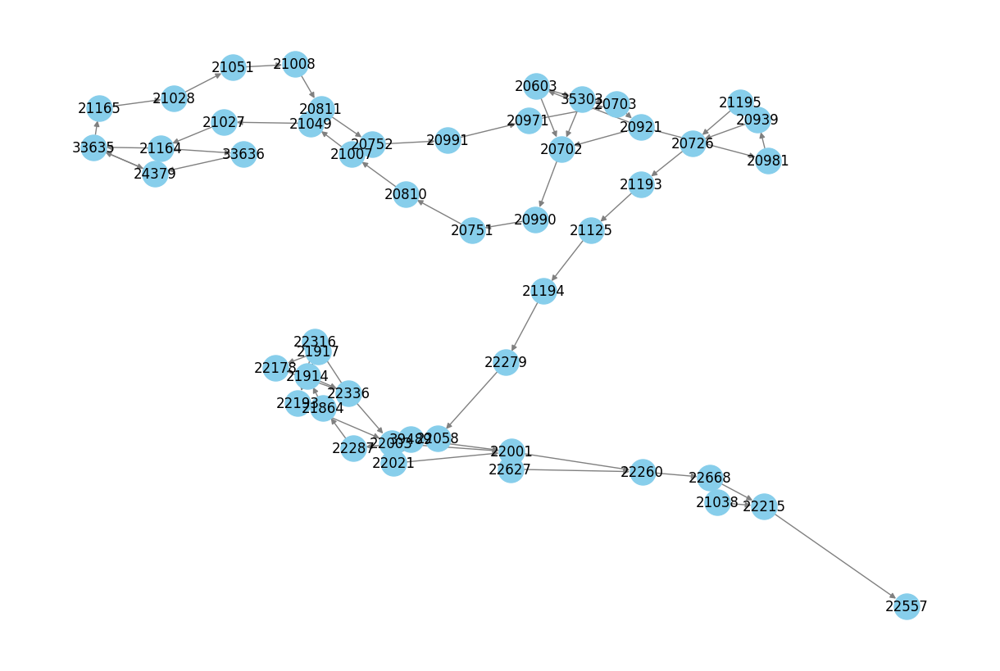

In [ ]:
import networkx as nx
import matplotlib.pyplot as plt

# Sample subgraph
nodes_sample = list(G.nodes)[:50]
subG = G.subgraph(nodes_sample)

plt.figure(figsize=(12, 8))
nx.draw(subG, with_labels=True, node_color="skyblue", edge_color="gray", node_size=500)
plt.show()


In [ ]:
import pickle
import networkx as nx

GRAPH_PATH = "/content/drive/MyDrive/SmartSafar/city_routes_graph.pkl"

# Load graph using pickle
with open(GRAPH_PATH, "rb") as f:
    G = pickle.load(f)

print(f"🛑 Total stops (nodes): {G.number_of_nodes()}")
print(f"🛣️ Total segments (edges): {G.number_of_edges()}")

# Optional: sample nodes
print("\nSample nodes:")
for n, data in list(G.nodes(data=True))[:5]:
    print(n, data)

# Optional: sample edges
print("\nSample edges:")
for u, v, data in list(G.edges(data=True))[:5]:
    print(f"{u} -> {v}", data)


🛑 Total stops (nodes): 9347
🛣️ Total segments (edges): 16102

Sample nodes:
20921 {'stop_name': 'kempegowda bus station', 'latitude': 12.977510452270508, 'longitude': 77.5714111328125}
20603 {'stop_name': 'ananda rao circle', 'latitude': 12.981149673461914, 'longitude': 77.57466125488281}
35303 {'stop_name': 'swastik sheshadripuram college', 'latitude': 12.987979888916016, 'longitude': 77.57421875}
20702 {'stop_name': 'central', 'latitude': 12.990059852600098, 'longitude': 77.57199096679688}
20990 {'stop_name': 'malleshwara circle', 'latitude': 12.996760368347168, 'longitude': 77.56877136230469}

Sample edges:
20921 -> 20603 {'route_id': 15989, 'route_short_name': '266-ra', 'distance_km': 0.5364999771118164, 'bearing_deg': 41.02439498901367, 'segment_id': '183030_15989', 'cumulative_distance': 0.5364999771118164, 'orientation_bin': 30, 'segment_length_m': 536.4999678386438, 'total_route_distance_km': 15.77962589263916}
20921 -> 20981 {'route_id': 16141, 'route_short_name': '210-ca', 'd

In [ ]:
# Print first 5 nodes with data
for n, data in list(G.nodes(data=True))[:5]:
    print(n, data)


20921 {'stop_name': 'kempegowda bus station', 'latitude': 12.977510452270508, 'longitude': 77.5714111328125}
20603 {'stop_name': 'ananda rao circle', 'latitude': 12.981149673461914, 'longitude': 77.57466125488281}
35303 {'stop_name': 'swastik sheshadripuram college', 'latitude': 12.987979888916016, 'longitude': 77.57421875}
20702 {'stop_name': 'central', 'latitude': 12.990059852600098, 'longitude': 77.57199096679688}
20990 {'stop_name': 'malleshwara circle', 'latitude': 12.996760368347168, 'longitude': 77.56877136230469}


In [ ]:
import folium
import random

def visualize_graph(G, sample_edges=None, edge_color="blue", edge_weight=2):
    """
    Visualize a NetworkX directed graph of bus stops and segments using Folium.
    G: NetworkX graph
    sample_edges: int or None, if specified only draw this many edges randomly
    """
    # Center map at mean of all node lat/lon
    lats = [data['latitude'] for _, data in G.nodes(data=True)]
    lons = [data['longitude'] for _, data in G.nodes(data=True)]
    center_lat, center_lon = sum(lats)/len(lats), sum(lons)/len(lons)
    m = folium.Map(location=[center_lat, center_lon], zoom_start=12)

    # Draw edges
    edges = list(G.edges(data=True))
    if sample_edges:
        edges = random.sample(edges, min(sample_edges, len(edges)))

    for u, v, data in edges:
        folium.PolyLine(
            locations=[
                (G.nodes[u]['latitude'], G.nodes[u]['longitude']),
                (G.nodes[v]['latitude'], G.nodes[v]['longitude'])
            ],
            color=edge_color,
            weight=edge_weight,
            tooltip=f"Route: {data.get('route_short_name','')}, Distance: {data.get('distance_km',''):.2f} km"
        ).add_to(m)

    # Optionally, add markers for nodes (stops)
    for n, data in list(G.nodes(data=True))[:100]:  # only first 100 stops for clarity
        folium.CircleMarker(
            location=(data['latitude'], data['longitude']),
            radius=3,
            color='red',
            fill=True,
            fill_color='red',
            tooltip=data.get('stop_name','')
        ).add_to(m)

    return m


In [ ]:
# Check nodes without 'latitude' or 'longitude'
missing_lat = [n for n, d in G.nodes(data=True) if 'latitude' not in d]
missing_lon = [n for n, d in G.nodes(data=True) if 'longitude' not in d]

print("Nodes missing latitude:", missing_lat[:10])
print("Nodes missing longitude:", missing_lon[:10])


Nodes missing latitude: [20945, 23785, 27746, 23505, 26824, 35794, 35734, 35805, 31513, 31877]
Nodes missing longitude: [20945, 23785, 27746, 23505, 26824, 35794, 35734, 35805, 31513, 31877]


In [ ]:
import pandas as pd
import networkx as nx
import pickle
import os

# ✅ File paths
PARQUET_PATH = "/content/drive/MyDrive/SmartSafar/city_routes_static.parquet"  # tera static route file
GRAPH_PATH = "/content/drive/MyDrive/SmartSafar/city_routes_graph.pkl"        # final graph pickle

def build_graph(parquet_path, save_path):
    # Load Parquet
    print("📥 Loading static route data (Parquet)...")
    df = pd.read_parquet(parquet_path)
    print(f"✅ Loaded {len(df):,} rows and {len(df.columns)} columns")

    # Initialize directed graph
    G = nx.DiGraph()

    # --- Add all stops as nodes with lat/lon ---
    # from_stop_id
    from_nodes = df[['from_stop_id', 'from_stop_name', 'from_latitude', 'from_longitude']].drop_duplicates()
    for _, row in from_nodes.iterrows():
        G.add_node(row['from_stop_id'],
                   stop_name=row['from_stop_name'],
                   latitude=row['from_latitude'],
                   longitude=row['from_longitude'])

    # to_stop_id
    to_nodes = df[['to_stop_id', 'to_stop_name', 'to_latitude', 'to_longitude']].drop_duplicates()
    for _, row in to_nodes.iterrows():
        G.add_node(row['to_stop_id'],
                   stop_name=row['to_stop_name'],
                   latitude=row['to_latitude'],
                   longitude=row['to_longitude'])

    # --- Add edges (segments) with attributes ---
    edge_cols = ['from_stop_id', 'to_stop_id', 'route_id', 'route_short_name',
                 'distance_km', 'bearing_deg', 'segment_id', 'cumulative_distance_from_start',
                 'orientation_bin', 'segment_length_m', 'total_route_distance_km']

    for _, row in df[edge_cols].iterrows():
        G.add_edge(
            row['from_stop_id'],
            row['to_stop_id'],
            route_id=row['route_id'],
            route_short_name=row['route_short_name'],
            distance_km=row['distance_km'],
            bearing_deg=row['bearing_deg'],
            segment_id=row['segment_id'],
            cumulative_distance=row['cumulative_distance_from_start'],
            orientation_bin=row['orientation_bin'],
            segment_length_m=row['segment_length_m'],
            total_route_distance_km=row['total_route_distance_km']
        )

    print(f"🧱 Graph ready: {G.number_of_nodes():,} stops, {G.number_of_edges():,} edges")

    # --- Save graph as Pickle ---
    with open(save_path, "wb") as f:
        pickle.dump(G, f)
    print(f"💾 Graph saved to: {os.path.abspath(save_path)}")

    return G

# Run script
if __name__ == "__main__":
    G = build_graph(PARQUET_PATH, GRAPH_PATH)


📥 Loading static route data (Parquet)...
✅ Loaded 186,008 rows and 32 columns
🧱 Graph ready: 9,347 stops, 16,102 edges
💾 Graph saved to: /content/drive/MyDrive/SmartSafar/city_routes_graph.pkl


In [ ]:
import folium
from folium.plugins import MarkerCluster
import random

def visualize_full_graph(G, sample_edges=8000, edge_color='blue', edge_weight=2):
    """
    Full interactive city routes map with hover info.
    sample_edges: maximum edges to draw for performance
    """
    # Map center
    lats = [data['latitude'] for _, data in G.nodes(data=True)]
    lons = [data['longitude'] for _, data in G.nodes(data=True)]
    center_lat, center_lon = sum(lats)/len(lats), sum(lons)/len(lons)
    m = folium.Map(location=[center_lat, center_lon], zoom_start=12, tiles='CartoDB positron')

    # Node markers (clustered)
    marker_cluster = MarkerCluster().add_to(m)
    for n, data in G.nodes(data=True):
        folium.CircleMarker(
            location=(data['latitude'], data['longitude']),
            radius=3,
            color='red',
            fill=True,
            fill_opacity=0.7,
            tooltip=f"{data['stop_name']} (ID: {n})"
        ).add_to(marker_cluster)

    # Edge plotting (sample for performance)
    edges_to_plot = list(G.edges(data=True))
    if sample_edges and len(edges_to_plot) > sample_edges:
        edges_to_plot = random.sample(edges_to_plot, sample_edges)

    for u, v, data in edges_to_plot:
        folium.PolyLine(
            locations=[(G.nodes[u]['latitude'], G.nodes[u]['longitude']),
                       (G.nodes[v]['latitude'], G.nodes[v]['longitude'])],
            color=edge_color,
            weight=edge_weight,
            tooltip=f"Route: {data['route_short_name']}, Dist: {data['distance_km']:.2f} km"
        ).add_to(m)

    return m

# Use in Colab/Jupyter
m = visualize_full_graph(G, sample_edges=8000)
m


In [ ]:
import pandas as pd

# Path to cleaned sample vehicle data
input_file = "/content/drive/MyDrive/SmartSafar/raw/parquet/date=2025-07-30/part-00000-1719398b-e1d4-4123-8e3c-997dc46a9599.c000.snappy_flat.parquet"

# Load data
df = pd.read_parquet(input_file)
df.head(500)


,id,system_time,current_status,stop_id,vehicle_timestamp,trip_id,start_time,start_date,schedule_relationship,route_id,latitude,longitude,bearing,vehicle_id,label
0,6916,2025-07-30T08:00:05.895488,1,"""21643""","""1753862367""","""66645864""","""07:05:00""","""20250730""","""SCHEDULED""","""15823""",12.963566,77.505150,173.00,"""28046""","""KA51AK8308"""
1,9650,2025-07-30T11:51:55.822490,1,"""38058""","""1753876244""","""66679143""","""09:50:00""","""20250730""","""SCHEDULED""","""1709""",12.965585,77.625275,313.00,"""26578""","""KA51AJ6380"""
2,2693,2025-07-30T08:00:05.895488,1,"""38058""","""1753862378""","""66645930""","""07:50:00""","""20250730""","""SCHEDULED""","""2357""",13.085287,77.553780,244.00,"""15382""","""KA57F2365"""
3,5894,2025-07-30T11:51:55.822490,1,"""20960""","""1753876276""","""66788282""","""10:20:00""","""20250730""","""SCHEDULED""","""2981""",12.956435,77.714973,53.00,"""28364""","""KA01AR1152"""
4,8122,2025-07-30T08:00:05.895488,1,"""38058""","""1753862373""","""66609808""","""07:30:00""","""20250730""","""SCHEDULED""","""3813""",13.196049,77.653763,236.00,"""19979""","""KA57F1802"""
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
495,383,2025-07-30T11:51:55.822490,1,"""38058""","""1753876307""","""66584640""","""10:30:00""","""20250730""","""SCHEDULED""","""2982""",12.916920,77.590073,19.00,"""28340""","""KA01AR0400"""
496,1326,2025-07-30T08:00:05.895488,1,"""38058""","""1753862372""","""66788656""","""07:55:00""","""20250730""","""SCHEDULED""","""12085""",12.910989,77.651871,183.00,"""22608""","""KA57F1358"""
497,9576,2025-07-30T11:51:55.822490,1,"""38058""","""1753876290""","""66632352""","""10:20:00""","""20250730""","""SCHEDULED""","""16018""",13.007921,77.691519,259.61,"""27656""","""KA57F6172"""
498,215,2025-07-30T08:00:05.895488,1,"""38058""","""1753862395""","""66652387""","""08:05:00""","""20250730""","""SCHEDULED""","""5415""",12.942578,77.558098,15.00,"""15100""","""KA57F1128"""


In [ ]:
import os

processed_dir = "/content/drive/MyDrive/SmartSafar/raw/parquet"

# Get all parquet files
parquet_files = [os.path.join(dp, f) for dp, dn, filenames in os.walk(processed_dir)
                 for f in filenames if f.endswith('.parquet')]

total_size_bytes = sum(os.path.getsize(f) for f in parquet_files)
total_size_gb = total_size_bytes / (1024**3)

print(f"Total processed parquet size: {total_size_gb:.2f} GB")


Total processed parquet size: 45.71 GB


In [ ]:
import os
import pandas as pd
from tqdm import tqdm
import warnings

# ==========================
# Warning suppression
# ==========================
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=DeprecationWarning)

# ==========================
# Paths
# ==========================
input_folder = "/home/amit-jindar/SmartSafar/data/raw/parquet"
parquet_folder = "/home/amit-jindar/SmartSafar/data/processed/vehicles_by_id"

os.makedirs(parquet_folder, exist_ok=True)

# ==========================
# Function: Clean & save vehicle DataFrame
# ==========================
def process_vehicle_df(df, vid):
    """Clean and save a single vehicle DataFrame as Parquet."""
    out_path = os.path.join(parquet_folder, f"{vid}.parquet")
    if os.path.exists(out_path):
        return  # Already exists, skip

    # Timestamp cleanup
    if "vehicle_timestamp" not in df.columns:
        return
    df["vehicle_timestamp"] = pd.to_numeric(df["vehicle_timestamp"].astype(str).str.replace('"', "", regex=False), errors='coerce').astype("Int64")
    df["start_dt"] = pd.to_datetime(df["vehicle_timestamp"], unit="s", errors="coerce")

    df = df.dropna(subset=["start_dt"]).reset_index(drop=True)

    # Sort
    sort_cols = ["trip_id", "start_dt"] if "trip_id" in df.columns else ["start_dt"]
    df = df.sort_values(sort_cols).reset_index(drop=True)

    # Trip-wise duplicate removal
    if "trip_id" in df.columns:
        df = df.drop_duplicates(subset=["trip_id", "vehicle_timestamp"], keep="first")
    else:
        df = df.drop_duplicates(subset=["vehicle_timestamp"], keep="first")

    # Backward stop_id detection
    if "stop_id" in df.columns:
        if "trip_id" in df.columns:
            df = df.groupby("trip_id", group_keys=False).apply(lambda g: g[g["stop_id"].cummax() == g["stop_id"]])
        else:
            df = df[df["stop_id"].cummax() == df["stop_id"]]

    # time_next_sec calculation
    if "start_dt" in df.columns:
        if "trip_id" in df.columns:
            df["time_next_sec"] = (df.groupby("trip_id")["start_dt"].shift(-1) - df["start_dt"]).dt.total_seconds()
        else:
            df["time_next_sec"] = (df["start_dt"].shift(-1) - df["start_dt"]).dt.total_seconds()

        # Keep sane values
        df = df[df["time_next_sec"].notna()]
        df = df[df["time_next_sec"] >= 0]
        df = df[df["time_next_sec"] < 7200]

    # Save Parquet
    df.to_parquet(out_path, engine="pyarrow", index=False)

# ==========================
# Step 0: Fix existing Parquet filenames (remove quotes)
# ==========================
print("🔧 Fixing existing Parquet filenames (remove quotes)...")
for file in os.listdir(parquet_folder):
    if file.endswith(".parquet") and (file.startswith('"') or file.endswith('"')):
        old_path = os.path.join(parquet_folder, file)
        new_name = file.replace('"', '')
        new_path = os.path.join(parquet_folder, new_name)
        os.rename(old_path, new_path)
        print(f"Renamed: {file} → {new_name}")

# ==========================
# Main processing: CSV/Parquet → vehicle-wise clean Parquet
# ==========================
print("🚀 Starting Parquet pipeline...")

for root, _, files in os.walk(input_folder):
    for file in tqdm(files):
        if not (file.endswith(".csv") or file.endswith(".parquet")):
            continue
        file_path = os.path.join(root, file)

        try:
            if file.endswith(".csv"):
                chunksize = 200_000
                for chunk in pd.read_csv(file_path, chunksize=chunksize):
                    for vid, subdf in chunk.groupby("vehicle_id"):
                        process_vehicle_df(subdf, vid)
            else:  # Parquet
                df = pd.read_parquet(file_path)
                for vid, subdf in df.groupby("vehicle_id"):
                    process_vehicle_df(subdf, vid)

        except Exception as e:
            print(f"⚠️ Error processing {file}: {e}")

print("Pipeline complete! All clean vehicle Parquets saved in:", parquet_folder)

